In [12]:
import argparse
from pathlib import Path

import torch
import torch.nn as nn
from PIL import Image
from torchvision import transforms
from torchvision.utils import save_image

import net
from function import adaptive_instance_normalization, coral
import numpy as np
import matplotlib.pyplot as plt
from lib.depth_net import DepthV3
import torch.nn.functional as F

In [13]:
def test_transform(size, crop=True):
    transform_list = []
    if size != 0:
        transform_list.append(transforms.Resize(size))
    if crop:
        transform_list.append(transforms.CenterCrop(size))
    transform_list.append(transforms.ToTensor())
    transform = transforms.Compose(transform_list)
    return transform

In [14]:
depth_transform = test_transform(100, True)

In [15]:
def style_transfer(vgg, decoder, content, style, alpha=1.0,
                   interpolation_weights=None):
    assert (0.0 <= alpha <= 1.0)
    content_f = vgg(content)
    style_f = vgg(style)
    if interpolation_weights:
        _, C, H, W = content_f.size()
        feat = torch.FloatTensor(1, C, H, W).zero_().to(device)
        base_feat = adaptive_instance_normalization(content_f, style_f)
        for i, w in enumerate(interpolation_weights):
            feat = feat + w * base_feat[i:i + 1]
        content_f = content_f[0:1]
    else:
        feat = adaptive_instance_normalization(content_f, style_f)
    feat = feat * alpha + content_f * (1 - alpha)
    return decoder(feat)

In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
do_interpolation = False

In [17]:
output_dir = Path("output")
output_dir.mkdir(exist_ok=True, parents=True)

content_dir = Path("input/face_test/")
content_paths = [f for f in content_dir.glob('*.jpg')]

style_dir = Path("input/art_test/")
style_paths = [f for f in style_dir.glob('*.jpg')]


In [18]:
decoder = net.decoder
original_decoder = net.decoder
vgg = net.vgg
depth_net = DepthV3((100, 100)).cuda()
depth_net.load_state_dict(torch.load('models/depth_model_40_-1.076169682497328.pth'))

decoder.eval()
vgg.eval()
depth_net.eval()


vgg.load_state_dict(torch.load("models/vgg_normalised.pth"))
vgg = nn.Sequential(*list(vgg.children())[:31])

vgg.to(device)
decoder.to(device)
original_decoder.to(device)

content_size = 512
style_size = 512
crop = True
preserve_color = False
alpha = 1

content_tf = test_transform(content_size, crop)
style_tf = test_transform(style_size, crop)

In [19]:
def im_convert(tensor):
    image = tensor.clone().detach().numpy().squeeze()
    image = image.transpose(1, 2, 0)        
#     image = image * 0.5  + 0.5
    image = image.clip(0, 1)
    return image

In [20]:
def get_outputs(decoder):
    images = []

    for style_path in style_paths:
        for content_path in content_paths:
            content = content_tf(Image.open(str(content_path)))
            style = style_tf(Image.open(str(style_path)))
            origin_style = style
            if preserve_color:
                style = coral(style, content)
            style = style.to(device).unsqueeze(0)
            content = content.to(device).unsqueeze(0)
            with torch.no_grad():
                output = style_transfer(vgg, decoder, content, style, alpha)
            
            content_depth = depth_net(F.interpolate(content, size=100))
            style_depth = depth_net(F.interpolate(output, size=100))
            
            content = im_convert(content.cpu().squeeze())
            origin_style = im_convert(origin_style.cpu().squeeze())
            output = im_convert(output.cpu().squeeze())

   
            content_depth = content_depth.cpu().clone().detach().numpy().squeeze()
            style_depth = style_depth.cpu().clone().detach().numpy().squeeze()
            
            
            
            images.append((content, origin_style, output, content_depth, style_depth))
    return images

In [21]:
decoder.load_state_dict(torch.load("experiments/decoder_iter_62000.pth"))
outputs = get_outputs(decoder)
decoder.load_state_dict(torch.load("models/decoder.pth"))
original_outputs = get_outputs(decoder)

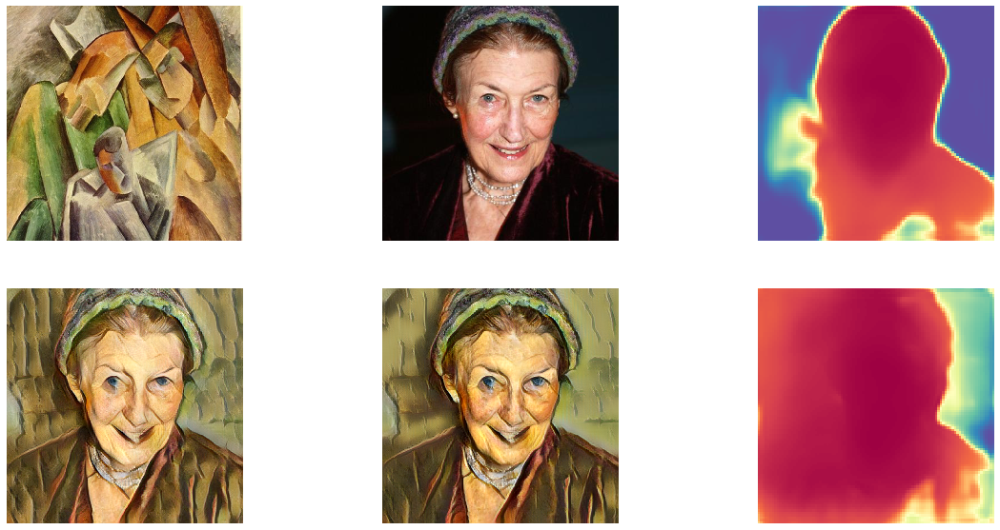

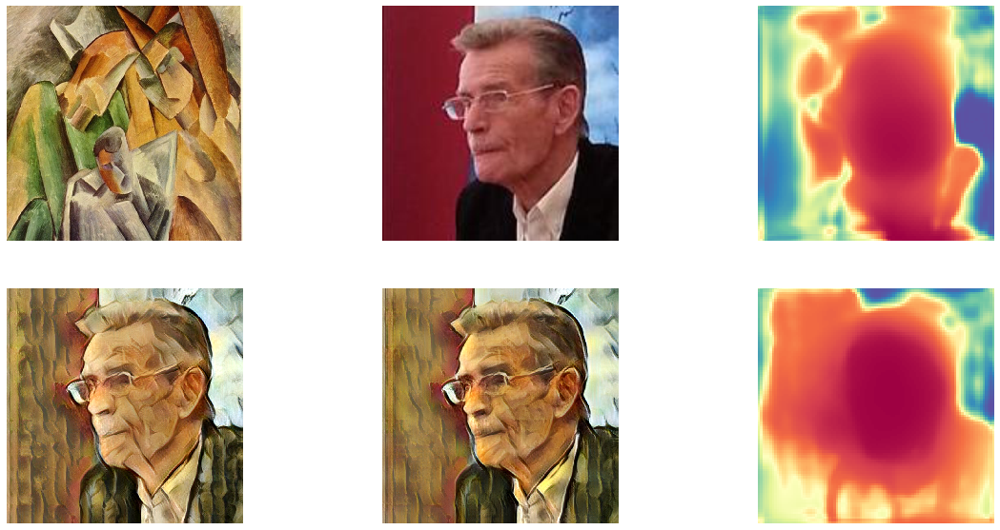

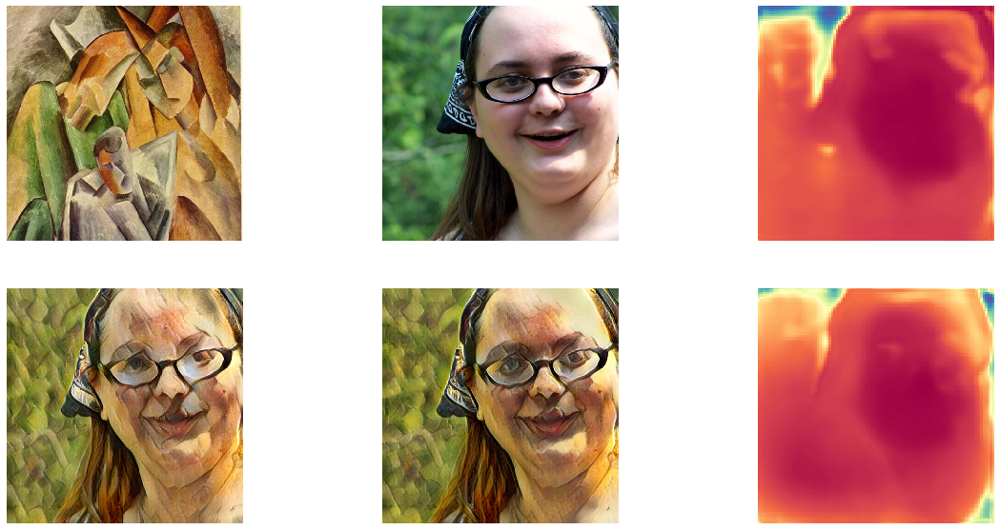

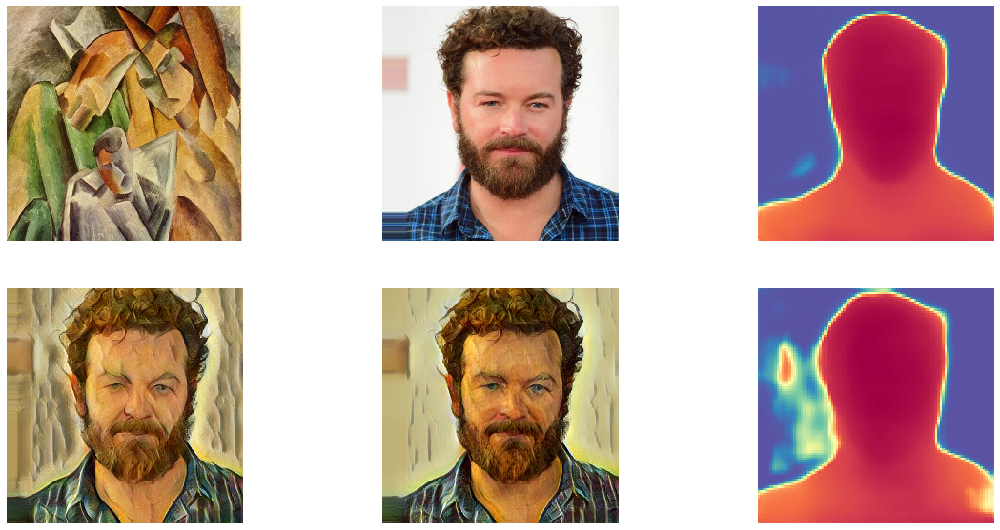

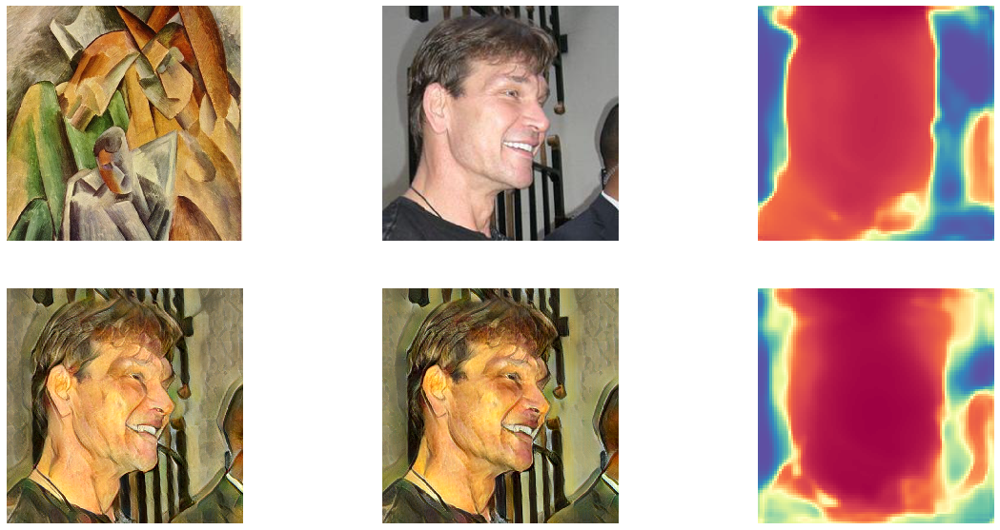

...

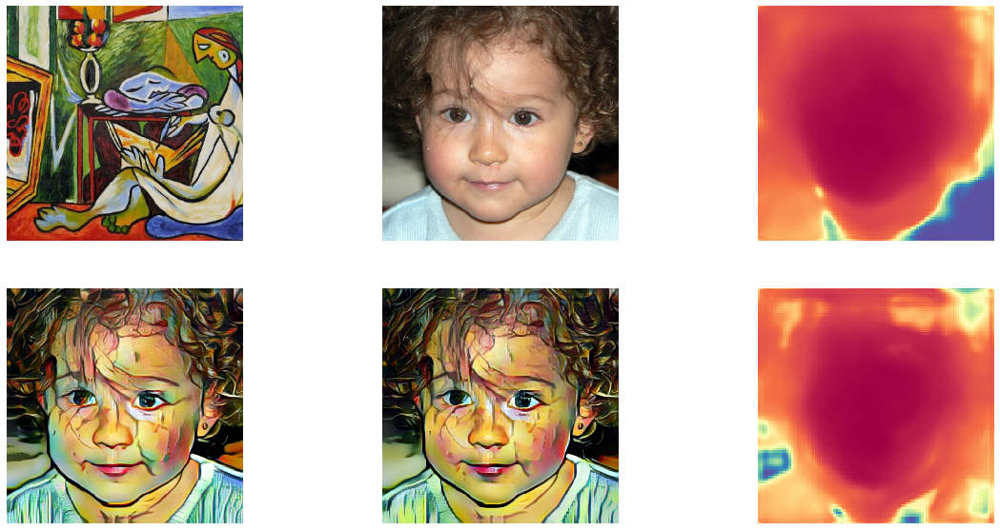

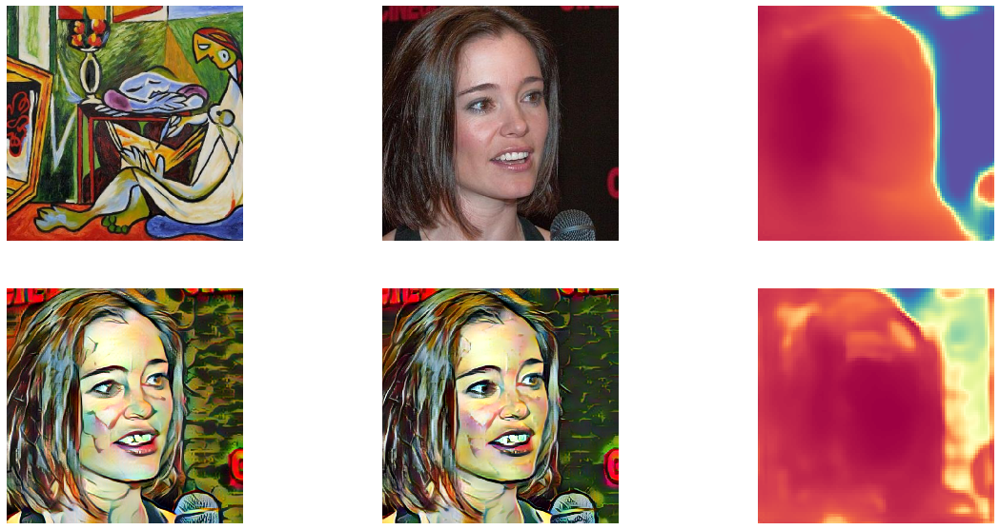

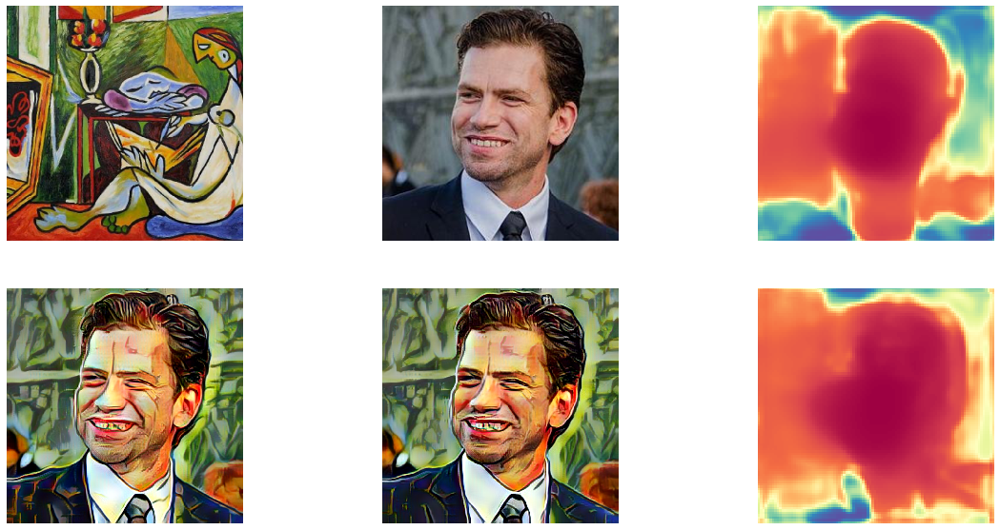

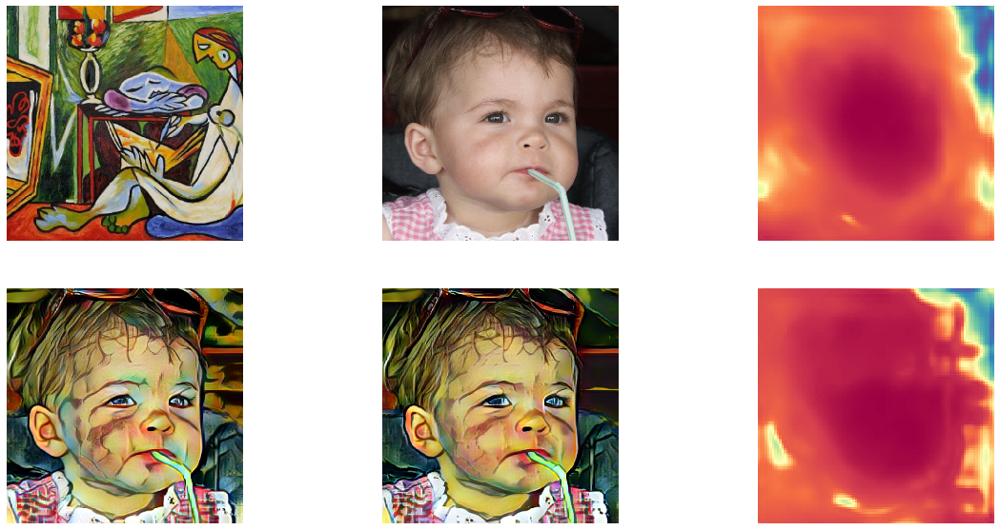

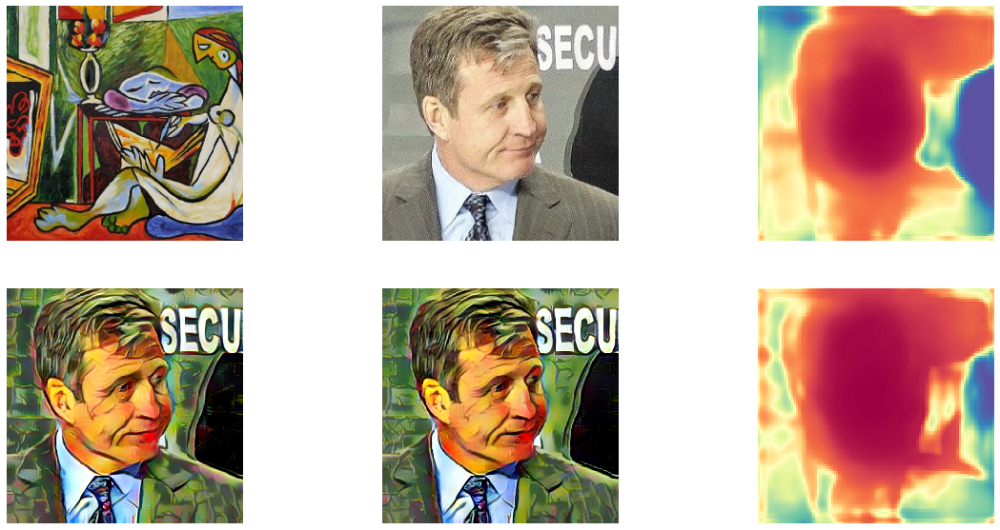

In [22]:
for i in range(len(outputs)):
    content, style, output, content_depth, style_depth = outputs[i]
    _, _, original_output, _, _= original_outputs[i]
    fig, ax = plt.subplots(2, 3, figsize=(20, 10))
    ax[0][0].imshow(style)
    ax[0][0].axis('off')
    ax[0][1].imshow(content)
    ax[0][1].axis('off')
    ax[0][2].imshow(content_depth, cmap='Spectral')
    ax[0][2].axis('off')
    ax[1][0].imshow(original_output)
    ax[1][0].axis('off')
    ax[1][1].imshow(output)
    ax[1][1].axis('off')
    ax[1][2].imshow(style_depth, cmap='Spectral')
    ax[1][2].axis('off')
    plt.show()